In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.linear_model import LinearRegression
df = pd.read_excel('./est20all.xls')

In [2]:
# df.shape

In [3]:
# df.columns

In [4]:
# df.head()

In [5]:
df = df.iloc[2:]

In [6]:
# df.head()

In [7]:
df.columns = df.iloc[0]
df = df[1:]

In [8]:
# df.head()

In [9]:
#df.columns
# df.head()

In [10]:
# df.describe()

In [11]:
# df.info()

In [12]:
unique_categories = df['Postal Code'].unique()

# print("Unique Categories:", unique_categories)

In [13]:
pd.set_option('display.max_seq_items', None)
unique_categories1 = df['Name'].unique()

# print("Unique Categories:", unique_categories1)

In [14]:
# print( df['Postal Code'].value_counts())

In [15]:
# print( df['Name'].value_counts())

In [16]:
# df.dtypes

In [17]:
# df.dtypes


In [18]:
# df.dtypes

In [19]:
# df.head()

In [20]:
new_df = df[['Poverty Estimate, All Ages', 'Median Household Income', 'County FIPS Code', 'Postal Code', 'Name']]
# new_df.head()

In [21]:
missing_data = df.isnull().sum()
# print("Missing data for each column:\n", missing_data)

In [22]:
quantitative_columns = df.select_dtypes(include=['float64', 'int64'])

# 2. Calculate the Pearson correlation coefficient matrix
correlation_matrix = quantitative_columns.corr(method='pearson')

# 3. Display the correlation matrix
# print("Pearson Correlation Coefficient Matrix:")
# print(correlation_matrix)

In [23]:
duplicates = df.duplicated()
# print("Duplicate Rows (True = Duplicate, False = Unique):")
# print(duplicates)

# 2. Get the total number of duplicate rows
num_duplicates = duplicates.sum()
# print(f"Total number of duplicate rows: {num_duplicates}")

# 3. Display duplicate rows, if any
# if num_duplicates > 0:
#     print("Duplicate rows in the DataFrame:")
#     print(df[duplicates])


In [24]:
new_df = df[['Poverty Estimate, All Ages', 'Median Household Income', 'County FIPS Code', 'Postal Code', 'Name']]


In [25]:
# new_df.head()
# new_df.head()

In [26]:
reldf = pd.read_excel('./2020_USRC_Group_Detail.xlsx', sheet_name = '2020 Group by County')

In [27]:
# reldf.head()

In [28]:
merged_df = pd.merge(new_df, reldf, left_on='Name', right_on='County Name', how='inner')

In [29]:
# merged_df

In [30]:
numeric_columns = merged_df.select_dtypes(include=[np.number])

# Calculate the Pearson correlation matrix for the numeric columns
correlation_matrix = numeric_columns.corr(method='pearson')

# Display the correlation matrix
# print("Pearson Correlation Matrix for Numeric Columns:")
# correlation_matrix


#### Regressions for high correlations

In [31]:
#Correlation : 0.508476
#linear regression for coreelation betweeen Congregations and Adherants 
# sns.regplot (x = 'Congregations', y= 'Adherents', data = merged_df)
# plt.ylim(0,)

In [32]:
#Correlation : 0.923591
#linear regression for coreelation betweeen Adherents as % of Total Adherents and Adherants  and Adherents as % of Total Population
# sns.regplot (x = 'Adherents as % of Total Adherents', y= 'Adherents as % of Total Population', data = merged_df)
# plt.ylim(0,)

In [33]:
#Correlation : 0.329593
#linear regression for corelation betweeen Adherents as % of Total Adherents and Adherants  and Congregations
#sns.regplot (x = 'Congregations', y= 'Adherents as % of Total Adherents', data = merged_df)
#plt.ylim(0,)

In [34]:
# the Pearson correlation between 'Group Name Numeric' and 'Median Household Income'
merged_df['Group Name Numeric'] = merged_df['Group Name'].astype('category').cat.codes


In [35]:
import geopandas as gpd
from vega_datasets import data
import altair as alt
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [36]:
import altair as alt

# Filter rows with valid adherents and group by 'Group Name'
filtered_df = merged_df[merged_df['Adherents'].notna() & (merged_df['Adherents'] > 0)]
group_adherents = filtered_df.groupby('Group Name').agg({'Adherents': 'sum'}).reset_index()

# Sort by 'Adherents' and keep the bottom 50 groups
bottom_50_groups = group_adherents.sort_values(by='Adherents', ascending=True).head(20)

# Create the pie chart
pie_chart_bottom = alt.Chart(bottom_50_groups).mark_arc().encode(
    theta=alt.Theta(field='Adherents', type='quantitative'),
    color=alt.Color(field='Group Name', type='nominal'),
    tooltip=['Group Name', 'Adherents']
).properties(
    width=400, 
    height=400,
    title='Bottom 20 Religious Congregations in the US by Adherents'
)

pie_chart_bottom


/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [37]:
import altair as alt

# Filter rows with valid adherents and group by 'Group Name'
filtered_df = merged_df[merged_df['Adherents'].notna() & (merged_df['Adherents'] > 0)]
group_adherents = filtered_df.groupby('Group Name').agg({'Adherents': 'sum'}).reset_index()

# Sort by 'Adherents' and keep the top 50 groups
top_50_groups = group_adherents.sort_values(by='Adherents', ascending=False).head(20)

# Create the pie chart
pie_chart2 = alt.Chart(top_50_groups).mark_arc().encode(
    theta=alt.Theta(field='Adherents', type='quantitative'),
    color=alt.Color(field='Group Name', type='nominal'),
    tooltip=['Group Name', 'Adherents']
).properties(
    width=400, 
    height=400,
    title='Top 20 Religious Congregations in the US by Adherents'
)

pie_chart2


/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [38]:
import altair as alt
filtered_df = merged_df[merged_df['Adherents'].notna() & (merged_df['Adherents'] > 0)]

group_adherents = filtered_df.groupby('Group Name').agg({'Adherents': 'sum'}).reset_index()

pie_chart = alt.Chart(group_adherents).mark_arc().encode(
    theta=alt.Theta(field='Adherents', type='quantitative'),
    color=alt.Color(field='Group Name', type='nominal'),
    tooltip=['Group Name', 'Adherents']
).properties(
    width=400, 
    height=400,
    title='Religious Congregations in the US and Total Adherents'
)

pie_chart + pie_chart2


/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.LayerChart(...)

In [39]:
import altair as alt
import pandas as pd
import requests
import json

# Load GeoJSON for U.S. counties from the URL using requests
url = 'https://raw.githubusercontent.com/vega/vega-datasets/master/data/us-10m.json'
response = requests.get(url)

# Load the JSON from the response
us_json = json.loads(response.text)

# Extract the counties' geometries and properties (if needed for mapping)
counties = alt.topo_feature(url, 'counties')  # Using TopoJSON for counties in Altair




In [40]:
import altair as alt
import pandas as pd

# Filter valid rows before computing the most popular congregations
filtered_df = merged_df[merged_df['Adherents'].notna() & (merged_df['Adherents'] > 0)]

# Get the top 3 congregations for each county
top_congregations = (
    filtered_df.sort_values(['FIPS', 'Adherents'], ascending=[True, False])
    .groupby('FIPS')
    .head(3)
    .assign(Rank=lambda df: df.groupby('FIPS').cumcount() + 1)
    .pivot(index='FIPS', columns='Rank', values='Group Name')
    .reset_index()
    .rename(columns={1: 'Top 1 Congregation', 2: 'Top 2 Congregation', 3: 'Top 3 Congregation'})
)

# Merge top congregations with county-level data
lookup_df = pd.merge(
    merged_df[['FIPS', 'County Name', 'State Name', 'Median Household Income']].drop_duplicates(),
    top_congregations,
    on='FIPS',
    how='left'
)

# Create the heatmap
heatmap = alt.Chart(counties).mark_geoshape().encode(
    color=alt.Color('Median Household Income:Q', scale=alt.Scale(scheme='blues'), title="Median Household Income"),
    tooltip=[
        'County Name:N', 
        'State Name:N', 
        'Median Household Income:Q',
        alt.Tooltip('Top 1 Congregation:N', title='Most Popular Congregation'),
        alt.Tooltip('Top 2 Congregation:N', title='Second Most Popular Congregation'),
        alt.Tooltip('Top 3 Congregation:N', title='Third Most Popular Congregation')
    ]
).transform_lookup(
    lookup='id',
    from_=alt.LookupData(
        lookup_df, 
        'FIPS', 
        ['County Name', 'State Name', 'Median Household Income', 'Top 1 Congregation', 'Top 2 Congregation', 'Top 3 Congregation']
    )
).project(
    type='albersUsa' 
).properties(
    width=900,
    height=600,
    title="Median Household Income by County and Top Congregations"
)

heatmap

/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/miniconda3/lib/python3.12/site-packages/altair/uti

alt.Chart(...)

In [41]:
import altair as alt

# Disable row limit for Altair
alt.data_transformers.disable_max_rows()

# Group adherents by state and group name
state_adherents = merged_df.groupby(['State Name', 'Group Name'])['Adherents'].sum().reset_index()

# Identify the top 50 groups
top_50_groups = state_adherents.groupby('Group Name')['Adherents'].sum().nlargest(50).index

# Filter data for the top 50 groups
filtered_state_df = state_adherents[state_adherents['Group Name'].isin(top_50_groups)]

# Add a "Base" option to show all groups
options = ['All Groups'] + filtered_state_df['Group Name'].unique().tolist()

# Create a dropdown selection for the religious groups
group_dropdown = alt.binding_select(
    options=options,
    name="Select Religious Group: "
)
group_select = alt.param(
    name="group_selection",
    bind=group_dropdown,
    value="All Groups"  # Default to "All Groups"
)

# Define a consistent color scheme
unique_groups = filtered_state_df['Group Name'].unique()
color_range = [
    "#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b",
    "#e377c2", "#7f7f7f", "#bcbd22", "#17becf"
]  # Add more colors if needed for more groups
color_scale = alt.Scale(
    domain=list(unique_groups),
    range=color_range[:len(unique_groups)]  # Ensure colors match the number of groups
)

# Create the bar chart
bar_chart = alt.Chart(filtered_state_df).mark_bar().encode(
    x=alt.X('State Name:N', title='State Name', axis=alt.Axis(labelAngle=-45)),
    y=alt.Y('Adherents:Q', title='Adherent Count'),
    color=alt.Color('Group Name:N', scale=color_scale, legend=None),  # Apply consistent color scale
    tooltip=['State Name', 'Group Name', 'Adherents']
).transform_filter(
    "group_selection == 'All Groups' || datum['Group Name'] == group_selection"  # Filter for "All Groups" or the selected group
).properties(
    width=1000,
    height=600,
    title="Adherent Count for Selected Religious Group per State"
)

# Combine the dropdown and bar chart
interactive_chart = alt.vconcat(
    alt.Chart().mark_text().encode(text=alt.value("")).add_params(group_select),
    bar_chart
).configure_axis(
    labelFontSize=10,
    titleFontSize=12
)

interactive_chart

/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.VConcatChart(...)

/var/folders/wm/1fxx7_tj47j792k0k8rxl5t40000gn/T/ipykernel_11899/2130335411.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/wm/1fxx7_tj47j792k0k8rxl5t40000gn/T/ipykernel_11899/2130335411.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



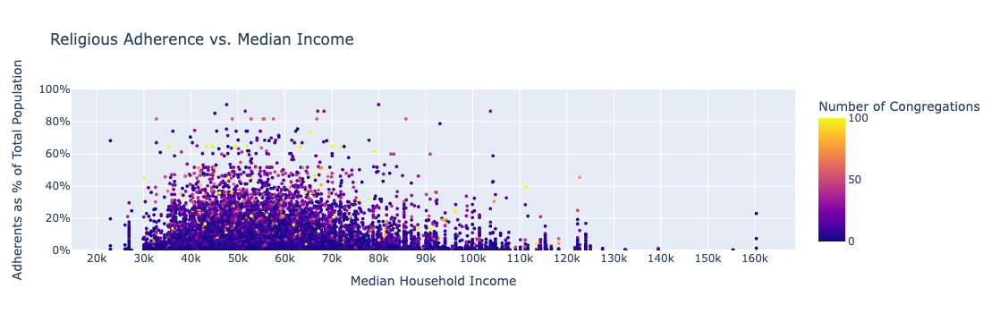

In [60]:
import pandas as pd
import plotly.express as px

# Exact column names from your dataset
median_income_col = "Median Household Income"
adherents_col = "Adherents as % of Total Population"
congregations_col = "Congregations"
state_col = "State Name"  # Assuming this is the column name for states

# Clean and preprocess the data
df = merged_df.dropna(subset=[median_income_col, adherents_col, congregations_col, state_col])

# Ensure dataset has no missing values for required columns
df[adherents_col] = pd.to_numeric(df[adherents_col], errors='coerce')
df[median_income_col] = pd.to_numeric(df[median_income_col], errors='coerce')

# Drop rows with invalid data
df = df.dropna(subset=[adherents_col, median_income_col])

# Filter dataset to include rows with significant adherents and median income
df_filtered = df[(df[adherents_col] > 0) & (df[median_income_col] > 0)]

# Increase sample size to show more data points (e.g., 75,000)
df_sampled = df_filtered.sample(n=min(75000, len(df_filtered)), random_state=42)

# Create interactive scatter plot using Plotly
fig = px.scatter(
    df_sampled,
    x=median_income_col,
    y=adherents_col,
    color=congregations_col,
    color_continuous_scale="plasma",
    range_color=[0, 100],  # Adjust color scale range to max 100
    hover_name="County Name",
    hover_data={  # Add additional hover data
        median_income_col: True,
        adherents_col: True,
        congregations_col: True,
        state_col: True,  # Include state in hover box
    },
    labels={
        median_income_col: "Median Household Income",
        adherents_col: "Adherents as % of Total Population",
        congregations_col: "Number of Congregations",
        state_col: "State",
    },
    title="Religious Adherence vs. Median Income",
    render_mode='webgl',  # Use WebGL for faster rendering
)

# Optimize rendering with slightly larger markers
fig.update_traces(marker=dict(size=4), mode='markers', selector=dict(type='scattergl'))

# Update layout with percentage formatting for y-axis
fig.update_layout(
    xaxis=dict(
        title="Median Household Income",
        tickmode='linear',
        dtick=10000,  # Adjust tick interval for clarity
    ),
    yaxis=dict(
        title="Adherents as % of Total Population",
        range=[0, 1],
        tickformat=".0%",  # Format as percentage
    ),
    coloraxis_colorbar=dict(
        title="Number of Congregations"
    ),
)

# Show the plot
fig.show()


In [43]:
#df.columns

In [44]:
# Convert 'Median Household Income' to numeric, coercing errors to NaN
merged_df['Median Household Income'] = pd.to_numeric(merged_df['Median Household Income'], errors='coerce')

# Drop rows where 'Median Household Income' is NaN
merged_df = merged_df.dropna(subset=['Median Household Income'])

# Proceed with grouping and sorting by 'Median Household Income'
poorest_50_counties = merged_df.groupby('County Name').agg({
    'Median Household Income': 'mean'
}).sort_values('Median Household Income', ascending=True).head(25).reset_index()

# Make a new DataFrame with the poorest counties
filtered_df = merged_df[merged_df['County Name'].isin(poorest_50_counties['County Name'])]

# Sum adherents by county and sort the counties by total adherents
county_adherents = filtered_df.groupby('County Name')['Adherents'].sum().reset_index()
county_adherents = county_adherents.sort_values('Adherents', ascending=False)

# Drop 'Adherents' from filtered_df to avoid conflicts, then merge with total adherents per county
filtered_df = filtered_df.drop(columns=['Adherents'], errors='ignore')
filtered_df = filtered_df.merge(county_adherents[['County Name', 'Adherents']], on='County Name', how='left')

# Get the top 10 congregations for each county
top_10_congregations = filtered_df.groupby(['County Name', 'Group Name']).agg({
    'Adherents': 'sum'
}).reset_index()

top_10_congregations = top_10_congregations.groupby('County Name').apply(
    lambda x: x.nlargest(10, 'Adherents')
).reset_index(drop=True)

# Creating the bar chart
import altair as alt

poorest_chart = alt.Chart(top_10_congregations).mark_bar().encode(
    x=alt.X('County Name:N', title='County Name',
            sort=county_adherents['County Name'].tolist(),
            axis=alt.Axis(labelAngle=-45)
    ),
    y=alt.Y('Adherents:Q', title='Adherents Count'),
    color='Group Name:N',
    tooltip=['County Name', 'Group Name', 'Adherents']
).properties(
    width=1000,
    height=600,
    title='Top 10 Congregations by Adherents Count in the Poorest 50 Counties'
).interactive()

#poorest_chart


/var/folders/wm/1fxx7_tj47j792k0k8rxl5t40000gn/T/ipykernel_11899/2385725848.py:28: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [45]:
# richest 50 counties
richest_50_counties = merged_df.groupby('County Name').agg({
    'Median Household Income': 'mean'
}).sort_values('Median Household Income', ascending=False).head(25).reset_index()

# create df with the richest counties
filtered_df2 = merged_df[merged_df['County Name'].isin(richest_50_counties['County Name'])]

# Sum adherents by county and sort the counties by total adherents
county_adherents = filtered_df2.groupby('County Name')['Adherents'].sum().reset_index()
county_adherents = county_adherents.sort_values('Adherents', ascending=False)

# Drop 'Adherents' from filtered_df to avoid conflicts, then merge with total adherents per county
filtered_df2 = filtered_df2.drop(columns=['Adherents'], errors='ignore')
filtered_df2 = filtered_df2.merge(county_adherents[['County Name', 'Adherents']], on='County Name', how='left')

# Get the top 10 congregations for each county
top_10_congregations2 = filtered_df2.groupby(['County Name', 'Group Name']).agg({
    'Adherents': 'sum'
}).reset_index()

top_10_congregations2 = top_10_congregations2.groupby('County Name').apply(
    lambda x: x.nlargest(10, 'Adherents')
).reset_index(drop=True)

# Creating the bar chart
import altair as alt

richest_chart = alt.Chart(top_10_congregations2).mark_bar().encode(
    x=alt.X('County Name:N', title='County Name',
            sort=county_adherents['County Name'].tolist(),
            axis=alt.Axis(labelAngle=-45)
    ),
    y=alt.Y('Adherents:Q', title='Adherents Count'),
    color='Group Name:N',
    tooltip=['County Name', 'Group Name', 'Adherents']
).properties(
    width=1000,
    height=600,
    title='Top 10 Congregations by Adherents Count in the Richest 50 Counties'
).interactive()

#richest_chart


/var/folders/wm/1fxx7_tj47j792k0k8rxl5t40000gn/T/ipykernel_11899/4284123515.py:22: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [46]:
import altair as alt

# Shared selection for congregation
congregation_selection = alt.selection_point(fields=['Group Name'], name="SelectCongregation")

# Define a consistent color scale
unique_groups = list(set(top_10_congregations['Group Name']).union(top_10_congregations2['Group Name']))
color_scale = alt.Scale(
    domain=unique_groups,
    range=[
            "#1f77b4",  # Blue
            "#ff7f0e",  # Orange
            "#2ca02c",  # Green
            "#d62728",  # Red
            "#9467bd",  # Purple
            "#17becf",  # Cyan
            "#e377c2",  # Pink
            "#bcbd22",  # Yellow-Green
            "#8c564b",  # Brick Red
            "#7f7f7f",  # Medium Grey (replaced by similar distinct color below)
            "#e15759",  # Coral
            "#4e79a7",  # Steel Blue
            "#f28e2c",  # Bright Orange
            "#76b7b2",  # Teal
            "#59a14f",  # Forest Green
            "#edc948",  # Goldenrod
            "#b07aa1",  # Lavender Purple
            "#ff9da7",  # Light Pink
            "#9c755f",  # Taupe (avoided brown tones here)
            "#f1ce63",  # Soft Yellow
            "#6b6ecf",  # Periwinkle
    ][:len(unique_groups)]  # Ensure enough colors are provided
)

# Fixed sort order for poorest counties
poorest_county_order = county_adherents['County Name'].tolist()

# Poorest counties chart
poorest_chart = alt.Chart(top_10_congregations).mark_bar().encode(
    x=alt.X('County Name:N', title='County Name',
            sort=poorest_county_order,  # Static sort order
            axis=alt.Axis(labelAngle=-45)),
    y=alt.Y('Adherents:Q', title='Adherents Count'),
    color=alt.Color('Group Name:N', scale=color_scale, legend=None),  # Apply consistent color scale
    tooltip=['County Name', 'Group Name', 'Adherents']
).transform_filter(
    congregation_selection  # Filter based on shared selection
).add_params(
    congregation_selection
).properties(
    width=500,
    height=600,
    title='Poorest 25 Counties'
)

# Fixed sort order for richest counties
richest_county_order = county_adherents['County Name'].tolist()

# Richest counties chart
richest_chart = alt.Chart(top_10_congregations2).mark_bar().encode(
    x=alt.X('County Name:N', title='County Name',
            sort=richest_county_order,  # Static sort order
            axis=alt.Axis(labelAngle=-45)),
    y=alt.Y('Adherents:Q', title='Adherents Count'),
    color=alt.Color('Group Name:N', scale=color_scale, legend=None),  # Apply consistent color scale
    tooltip=['County Name', 'Group Name', 'Adherents']
).transform_filter(
    congregation_selection  # Filter based on shared selection
).add_params(
    congregation_selection
).properties(
    width=500,
    height=600,
    title='Richest 25 Counties'
)

# Combine the two charts horizontally
combined_chart = alt.hconcat(poorest_chart, richest_chart).configure_axis(
    labelFontSize=10,
    titleFontSize=12
)

combined_chart


/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.

/opt/miniconda3/lib/python3.12/site-packages/altair/utils/core.py:395: FutureWarning:

the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False`

alt.HConcatChart(...)